**1. Take at least 100 images per class with at least 3 classes using your phone/camera (e.g. take photos of different types of trees, flowers or animals). Display 5 examples from each class.**

In [48]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [49]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
from scipy.spatial import procrustes
import seaborn as sns
from sklearn.manifold import TSNE
from sklearn.mixture import GaussianMixture
from sklearn.manifold import LocallyLinearEmbedding
from sklearn.manifold import MDS
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import os
import time
import numpy as np
from skimage import io, color,transform
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import warnings

In [50]:
zip_file_path = '/content/drive/My Drive/Q1_data.zip'
warnings.filterwarnings('ignore')

In [ ]:
warnings.filterwarnings('ignore')
!unzip '/content/drive/My Drive/Q1_data.zip' -d '/content/Q1_data'


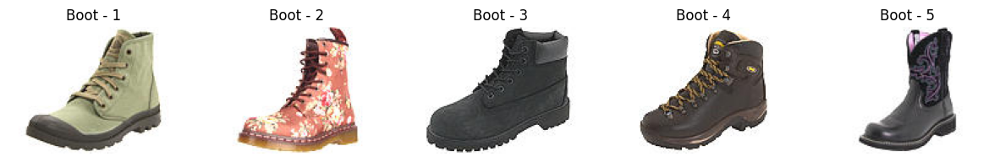

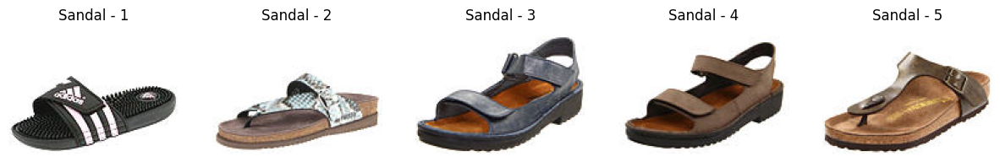

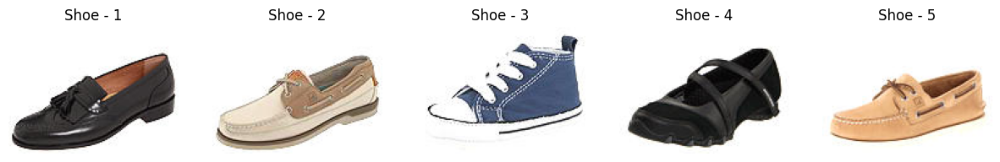

In [52]:
import os
import cv2
import matplotlib.pyplot as plt

folder_path = "/content/Q1_data/Q1_data"

def display_examples(class_folder):
    class_path = os.path.join(folder_path, class_folder)

    for i, image_file in enumerate(os.listdir(class_path)[:5]):
        image_path = os.path.join(class_path, image_file)

        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        plt.subplot(1, 5, i + 1)
        plt.imshow(image)
        plt.axis('off')
        plt.title(f'{class_folder} - {i + 1}')

plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
display_examples("Boot")
plt.show()
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 2)
display_examples("Sandal")
plt.show()
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 3)
display_examples("Shoe")

plt.show()


**2.Split the images into a training set, a validation set, and a test set.**

In [53]:
from sklearn.model_selection import train_test_split
import os
import shutil

# Define paths
input_folder = "/content/Q1_data/Q1_data"
output_folder = "/content/Q1_data/dataset_split"

# Function to create folders
def create_folders(output_path, classes):
    os.makedirs(output_path, exist_ok=True)
    for split in ['train', 'valid', 'test']:
        split_path = os.path.join(output_path, split)
        os.makedirs(split_path, exist_ok=True)
        for class_name in classes:
            class_path = os.path.join(split_path, class_name)
            os.makedirs(class_path, exist_ok=True)

# Function to split and move images
def split_and_move(class_folder):
    class_path = os.path.join(input_folder, class_folder)

    # Get a list of all image files in the class folder
    all_images = os.listdir(class_path)

    # Split the list into train, valid, and test sets
    train_images, test_images = train_test_split(all_images, test_size=0.2, random_state=42)
    valid_images, test_images = train_test_split(test_images, test_size=0.5, random_state=42)

    # Move images to their respective folders
    for img in train_images:
        shutil.move(os.path.join(class_path, img), os.path.join(output_folder, 'train', class_folder, img))

    for img in valid_images:
        shutil.move(os.path.join(class_path, img), os.path.join(output_folder, 'valid', class_folder, img))

    for img in test_images:
        shutil.move(os.path.join(class_path, img), os.path.join(output_folder, 'test', class_folder, img))

# Apply the function for each class
classes = ['Boot', 'Sandal', 'Shoe']

# Create folders
create_folders(output_folder, classes)

# Split and move images
for class_folder in classes:
    split_and_move(class_folder)


**3.Build the input pipeline, including the appropriate preprocessing operations, and add data augmentation.**

In [54]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define paths
train_data_path = "/content/Q1_data/dataset_split/train"
valid_data_path = "/content/Q1_data/dataset_split/valid"
test_data_path = "/content/Q1_data/dataset_split/test"

# Define image size and batch size
img_size = (224, 224)
batch_size = 32

# Create ImageDataGenerator for data augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Create data generators for training, validation, and test sets
train_generator = train_datagen.flow_from_directory(
    train_data_path,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical'
)

valid_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)
valid_generator = valid_datagen.flow_from_directory(
    valid_data_path,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical'
)

test_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)
test_generator = test_datagen.flow_from_directory(
    test_data_path,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Display class indices
print("Class indices:", train_generator.class_indices)


Found 240 images belonging to 3 classes.
Found 30 images belonging to 3 classes.
Found 30 images belonging to 3 classes.
Class indices: {'Boot': 0, 'Sandal': 1, 'Shoe': 2}


**4. Fine-tune a pretrained model of your choice on this dataset (the one you created in part 3). Report classification accuracy and give a few examples of correct/incorrect classification (show a few images that were correctly/incorrectly classified).**

In [55]:
import tensorflow as tf
from tensorflow.keras.applications import VGG16
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import preprocess_input, decode_predictions
import numpy as np

# Define paths
train_data_path = "/content/Q1_data/dataset_split/train"
valid_data_path = "/content/Q1_data/dataset_split/valid"
test_data_path = "/content/Q1_data/dataset_split/test"

# Define image size and batch size
img_size = (224, 224)
batch_size = 32

# Create VGG16 model with pre-trained weights (excluding the top layer)
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze convolutional layers
for layer in base_model.layers:
    layer.trainable = False

# Create a new model on top
model = tf.keras.Sequential([
    base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(256, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(3, activation='softmax')  # Assuming 3 classes (Boot, Shoe, Sandal)
])

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Create data generators for training, validation, and test sets
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

valid_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)
test_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_data_path,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical'
)

valid_generator = valid_datagen.flow_from_directory(
    valid_data_path,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical'
)

test_generator = test_datagen.flow_from_directory(
    test_data_path,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Train the model
history = model.fit(
    train_generator,
    epochs=7,
    validation_data=valid_generator
)

# Evaluate the model on the test set
test_loss, test_acc = model.evaluate(test_generator)
print(f'Test accuracy: {test_acc}')

# Predict on test set
test_predictions = model.predict(test_generator)

# Get class indices
class_indices = train_generator.class_indices
inverse_class_indices = {v: k for k, v in class_indices.items()}

# Get filenames and true labels from the generator
filenames = test_generator.filenames
true_labels = test_generator.classes

# Get predicted labels
predicted_labels = np.argmax(test_predictions, axis=1)

# Display a few examples of correct/incorrect classifications
correctly_classified_indices = np.where(predicted_labels == true_labels)[0]
incorrectly_classified_indices = np.where(predicted_labels != true_labels)[0]

# Display a few examples of correct classifications
print("Correctly classified examples:")
for i in correctly_classified_indices[:3]:
    img_path = os.path.join(test_data_path, filenames[i])
    img = image.load_img(img_path, target_size=(224, 224))
    img = image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = preprocess_input(img)
    print(f"True label: {inverse_class_indices[true_labels[i]]}, Predicted label: {inverse_class_indices[predicted_labels[i]]}")
    tf.keras.preprocessing.image.array_to_img(img[0]).show()

# Display a few examples of incorrect classifications
print("\nIncorrectly classified examples:")
for i in incorrectly_classified_indices[:3]:
    img_path = os.path.join(test_data_path, filenames[i])
    img = image.load_img(img_path, target_size=(224, 224))
    img = image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = preprocess_input(img)
    print(f"True label: {inverse_class_indices[true_labels[i]]}, Predicted label: {inverse_class_indices[predicted_labels[i]]}")
    tf.keras.preprocessing.image.array_to_img(img[0]).show()


Found 240 images belonging to 3 classes.
Found 30 images belonging to 3 classes.
Found 30 images belonging to 3 classes.
Epoch 1/7
8/8 [==============================] - 177s 22s/step - loss: 1.1508 - accuracy: 0.4042 - val_loss: 0.9796 - val_accuracy: 0.3333
Epoch 2/7
8/8 [==============================] - 160s 20s/step - loss: 1.0948 - accuracy: 0.4875 - val_loss: 0.7634 - val_accuracy: 0.8333
Epoch 3/7
8/8 [==============================] - 155s 19s/step - loss: 0.8766 - accuracy: 0.6167 - val_loss: 0.6509 - val_accuracy: 0.8333
Epoch 4/7
8/8 [==============================] - 152s 19s/step - loss: 0.7624 - accuracy: 0.6958 - val_loss: 0.5433 - val_accuracy: 0.9000
Epoch 5/7
8/8 [==============================] - 154s 19s/step - loss: 0.6692 - accuracy: 0.7625 - val_loss: 0.4517 - val_accuracy: 0.9667
Epoch 6/7
8/8 [==============================] - 153s 19s/step - loss: 0.5779 - accuracy: 0.8333 - val_loss: 0.3877 - val_accuracy: 1.0000
Epoch 7/7
1/1 [==============================

1/1 [==============================] - 21s 21s/step


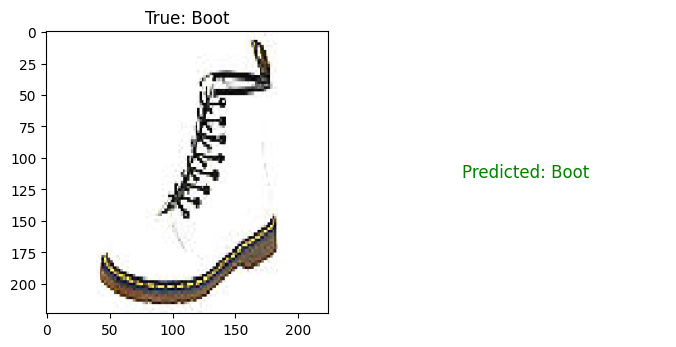

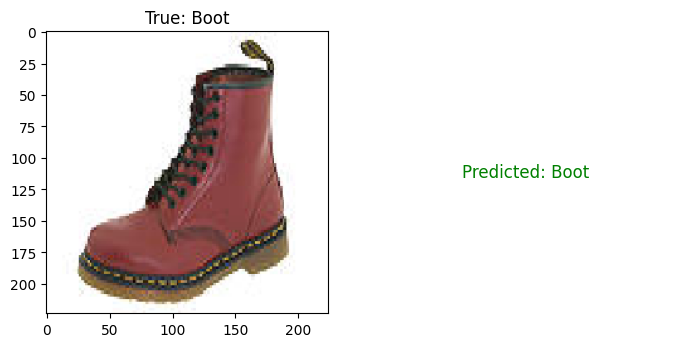

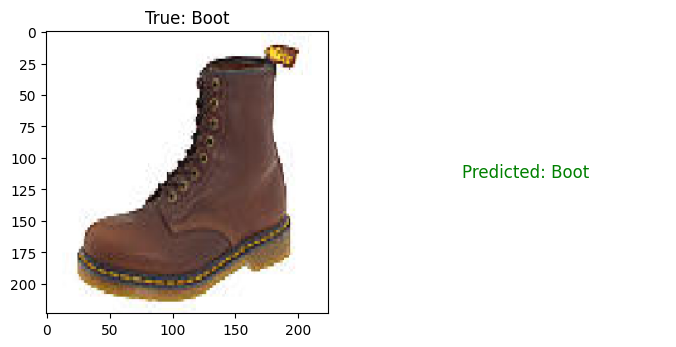

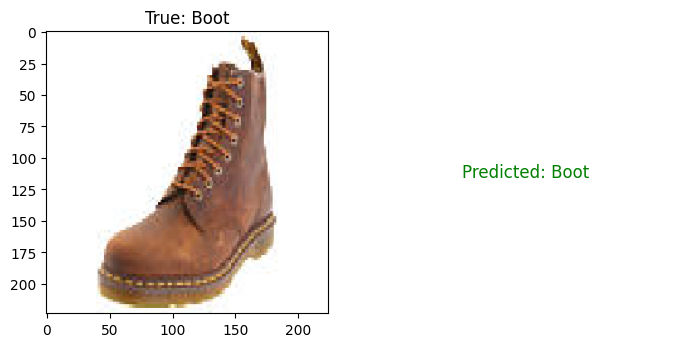

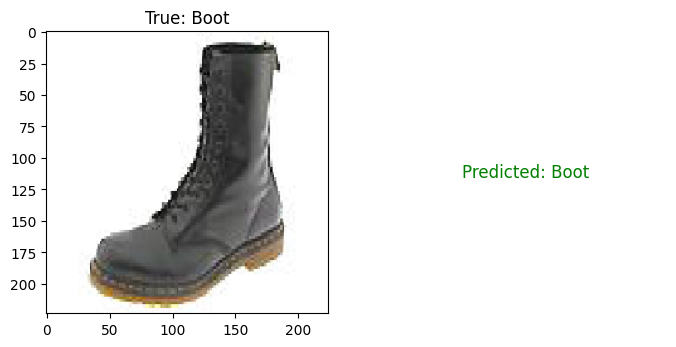

...

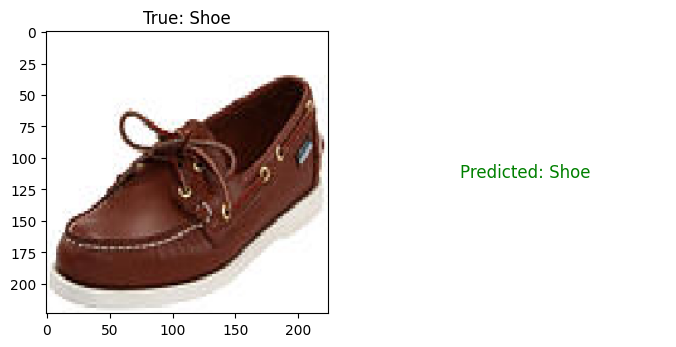

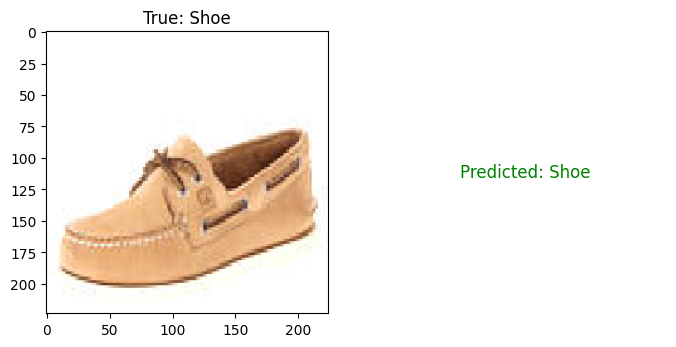

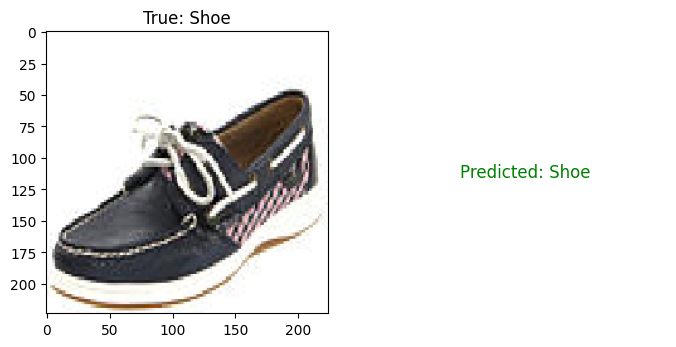

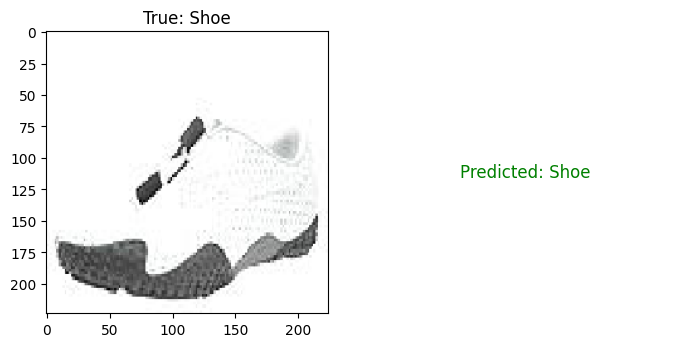

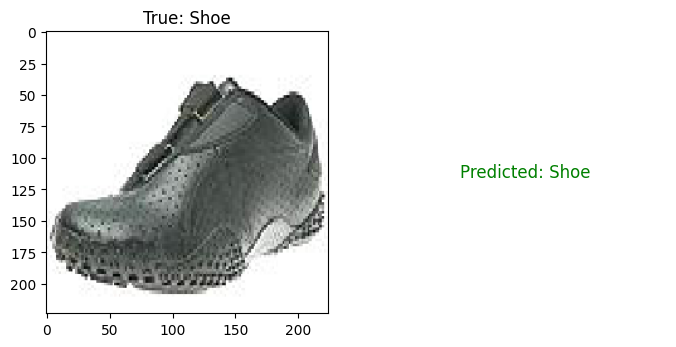

1/1 [==============================] - 17s 17s/step


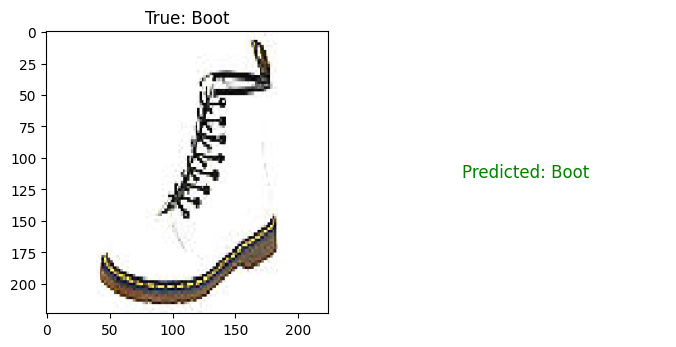

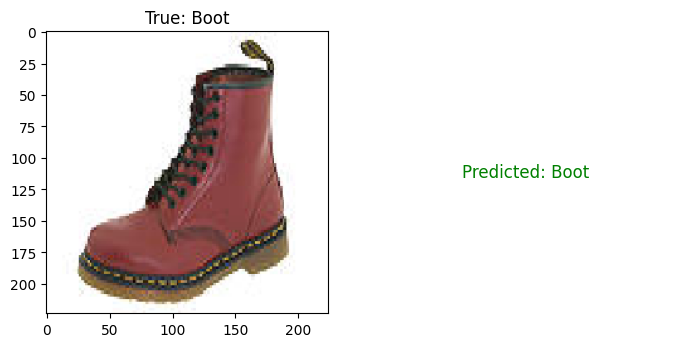

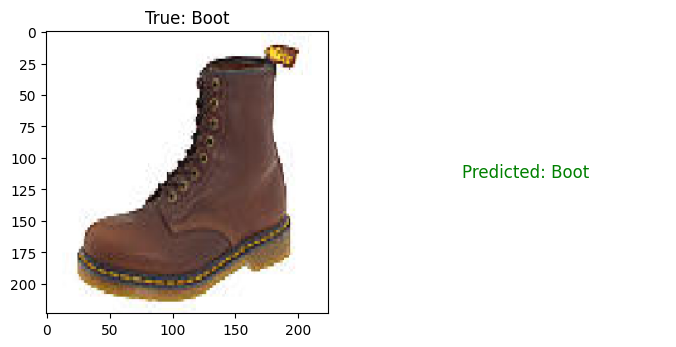

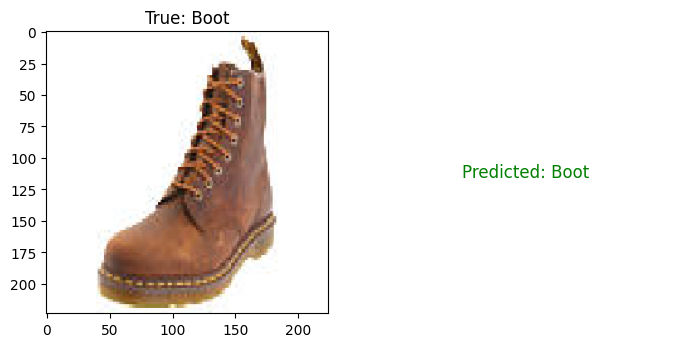

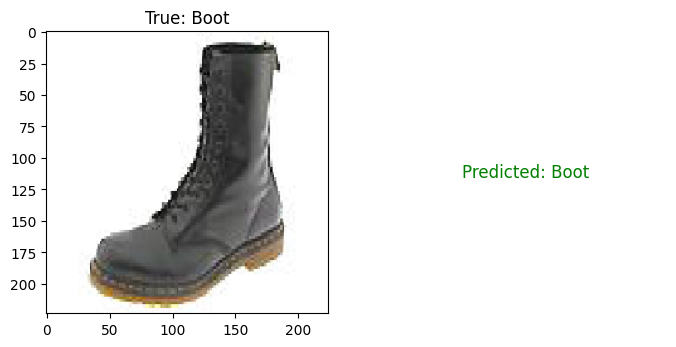

...

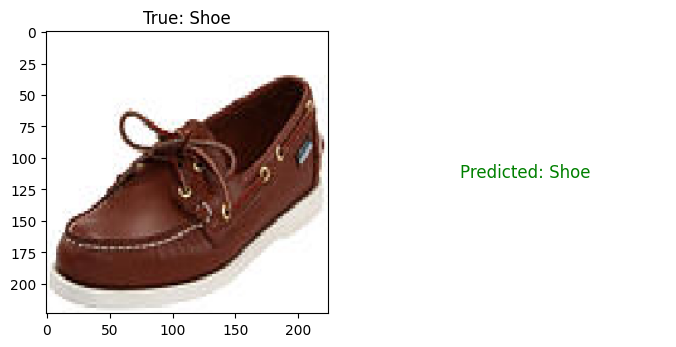

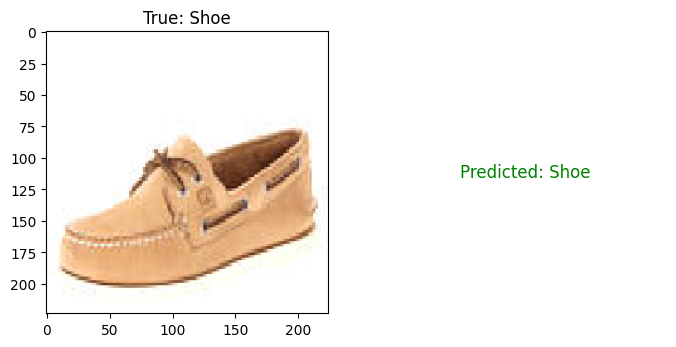

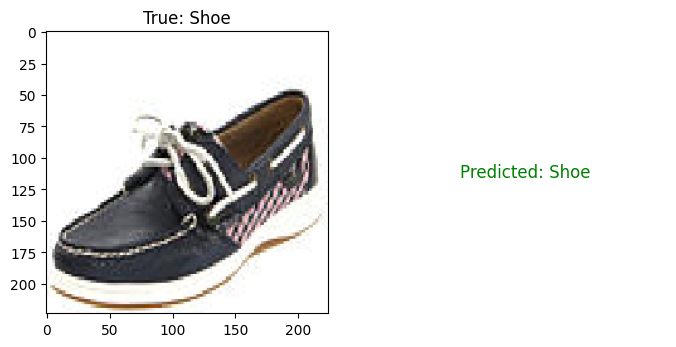

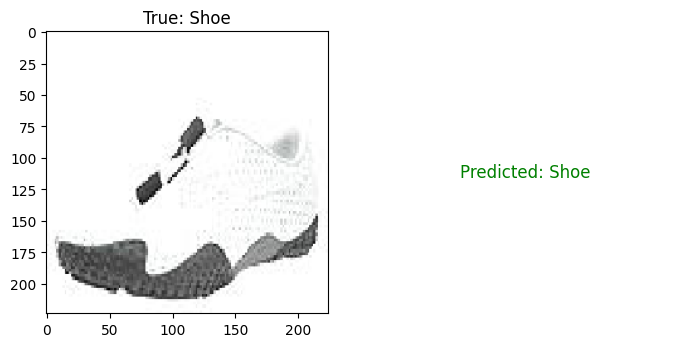

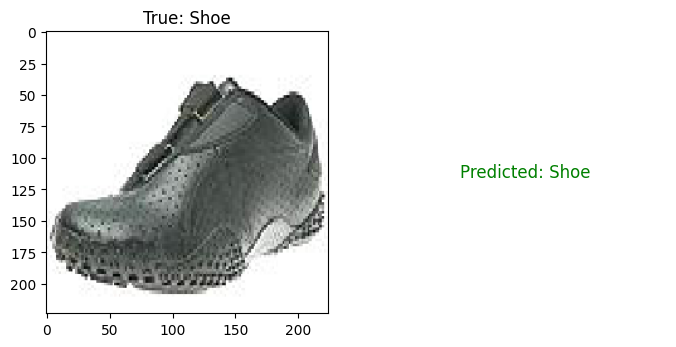

1/1 [==============================] - 17s 17s/step


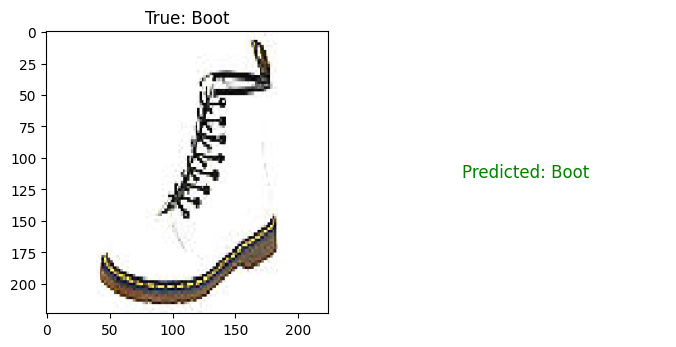

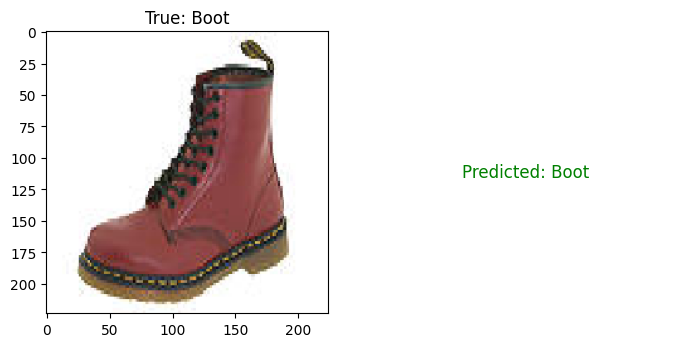

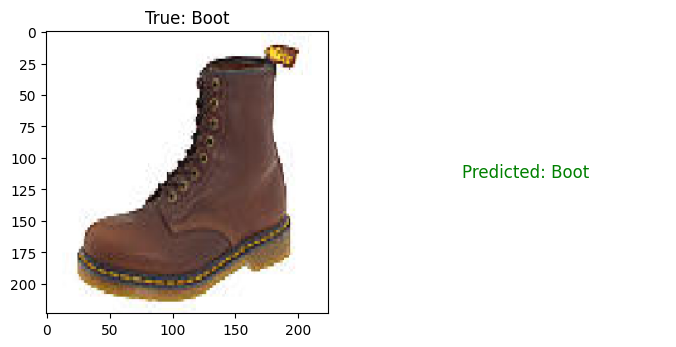

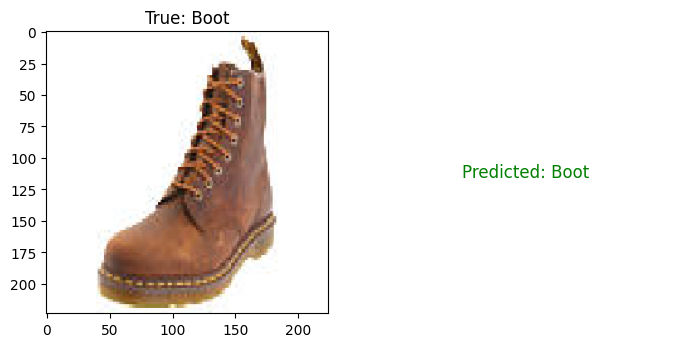

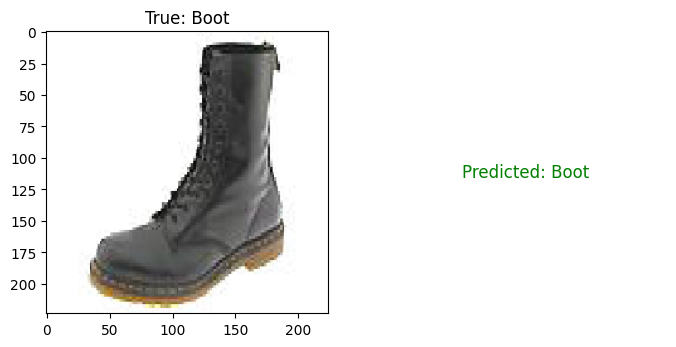

...

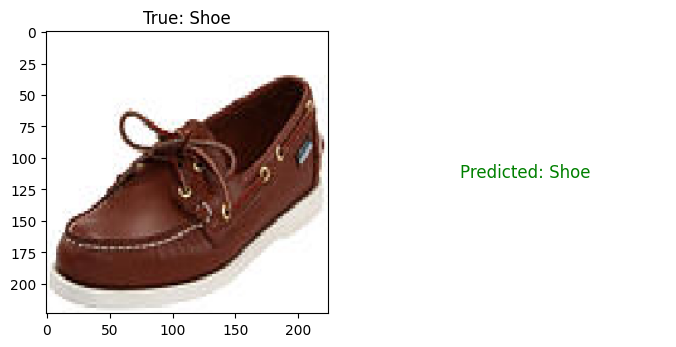

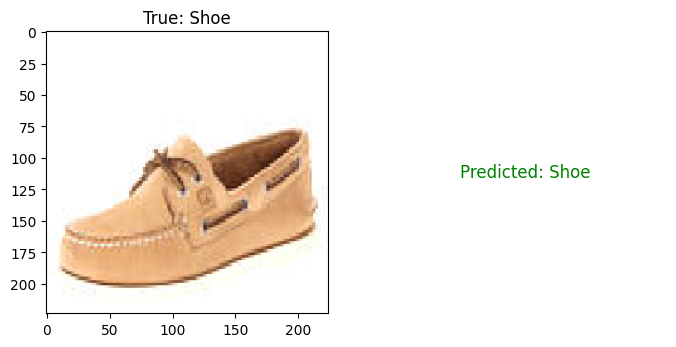

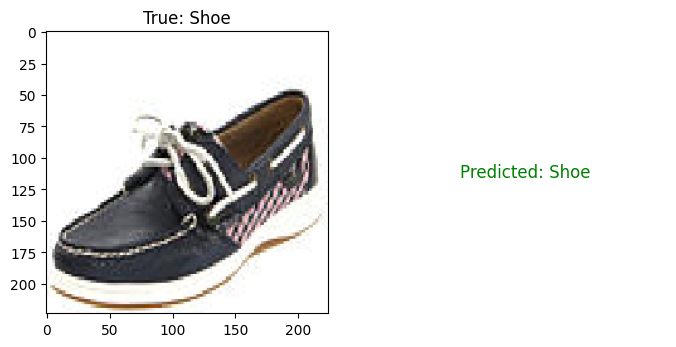

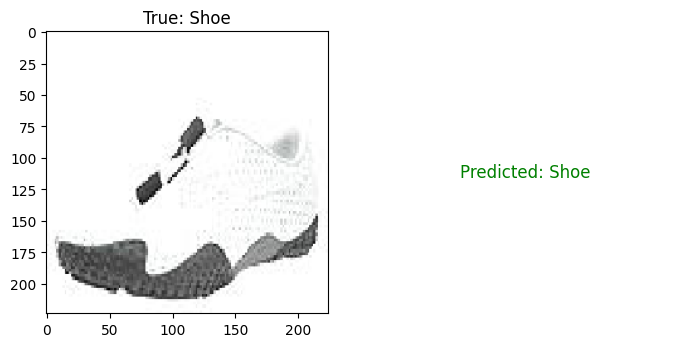

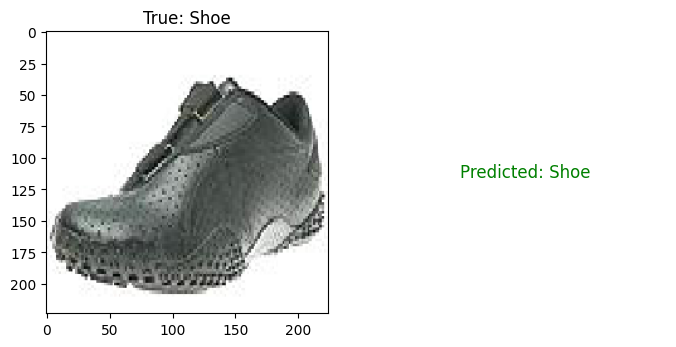

1/1 [==============================] - 17s 17s/step


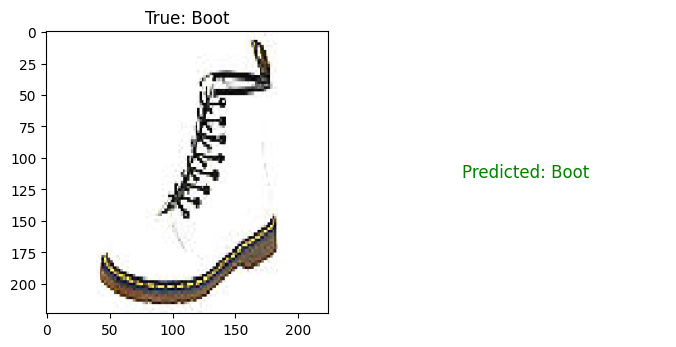

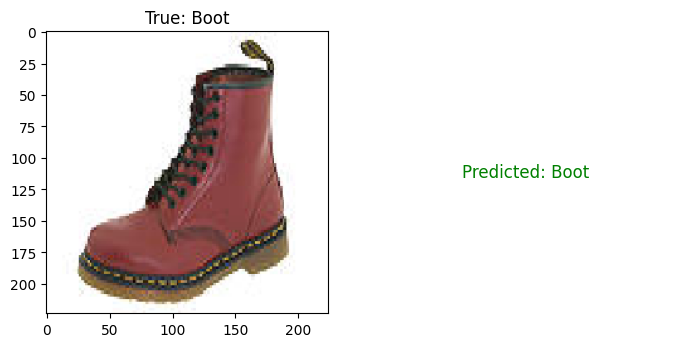

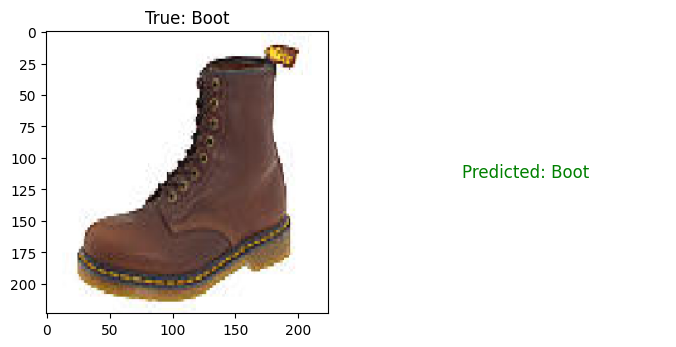

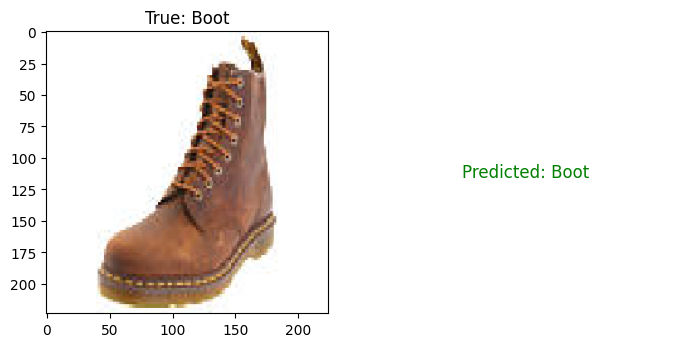

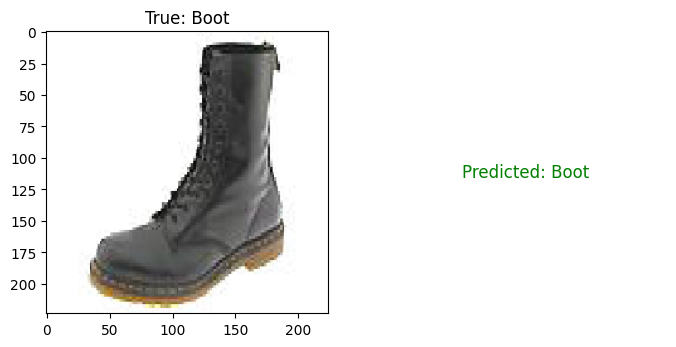

...

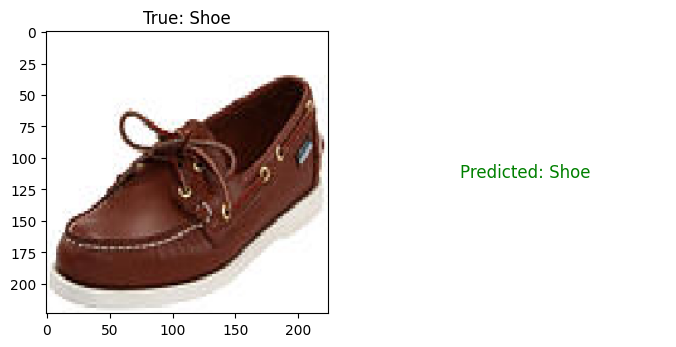

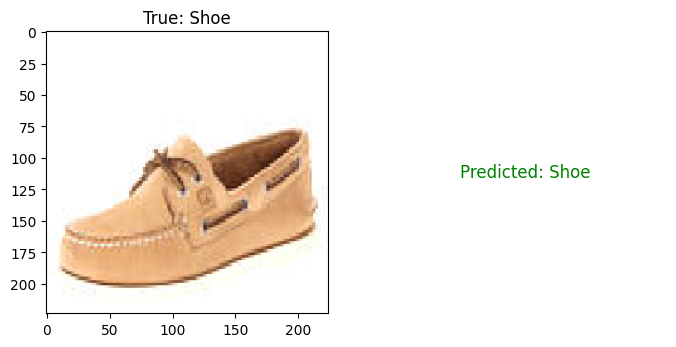

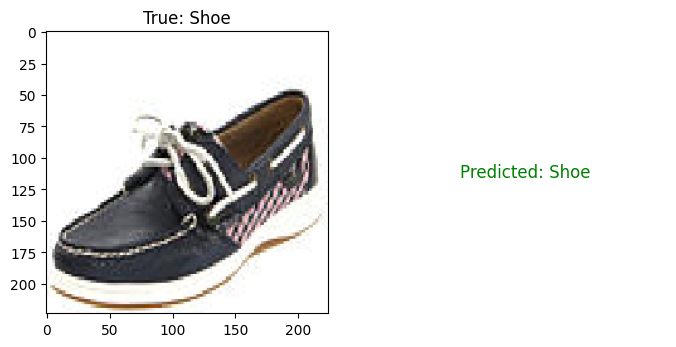

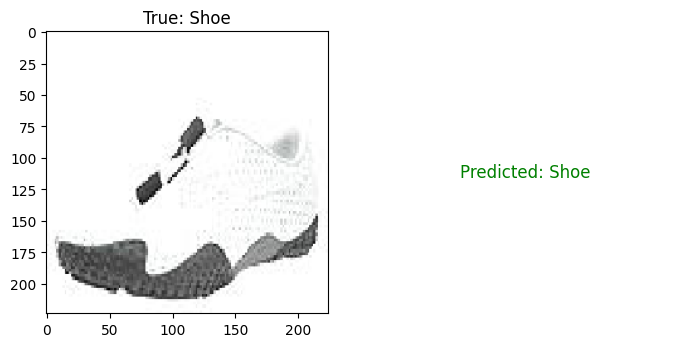

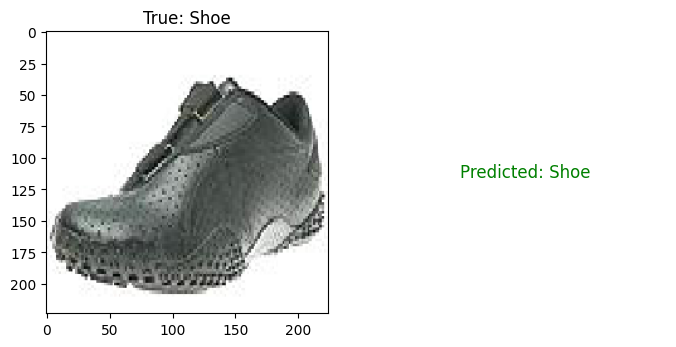

1/1 [==============================] - 18s 18s/step


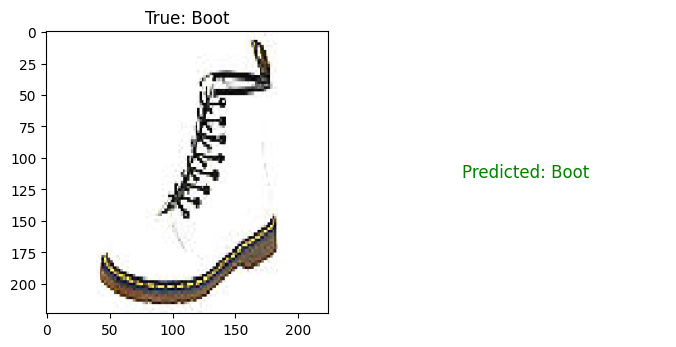

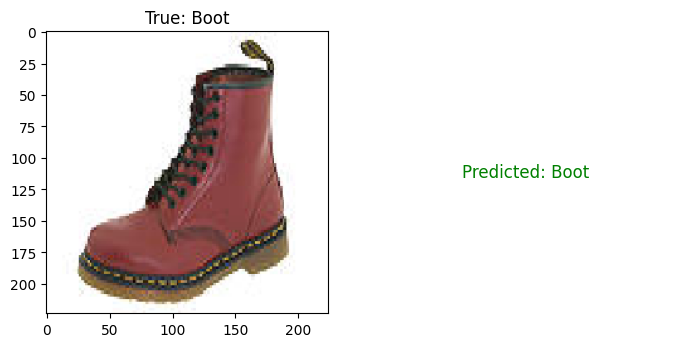

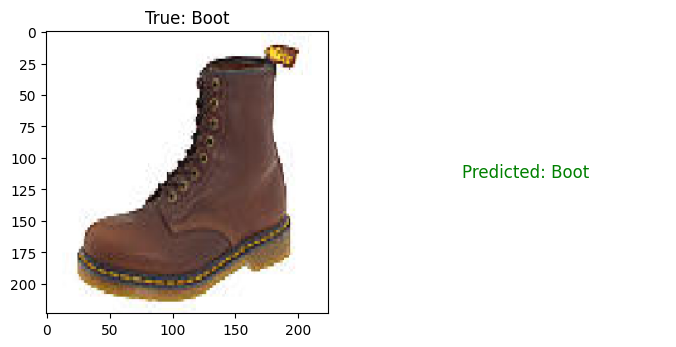

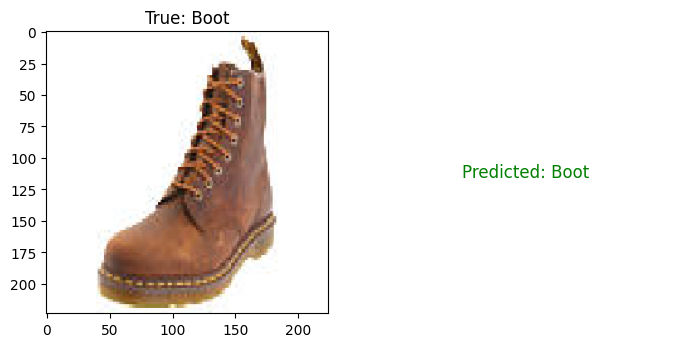

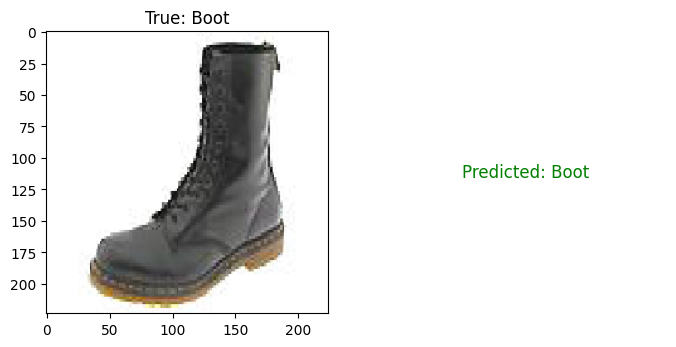

...

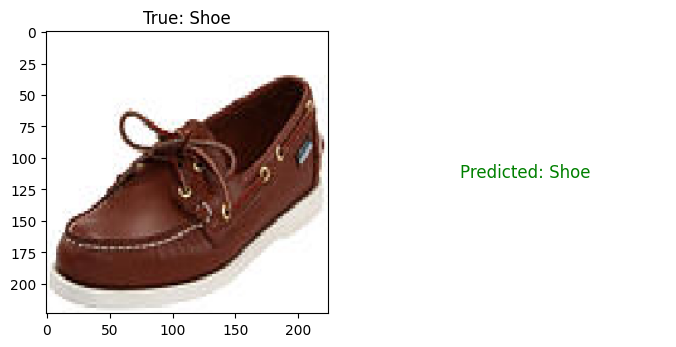

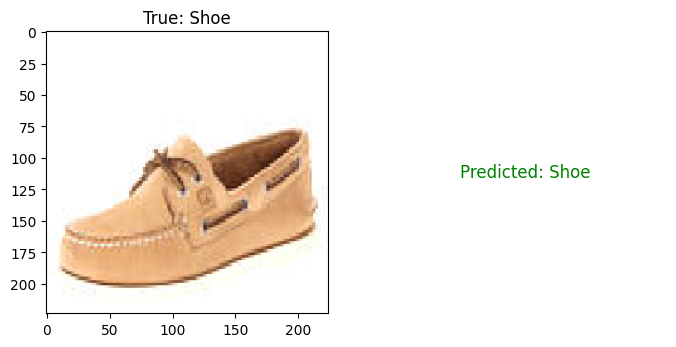

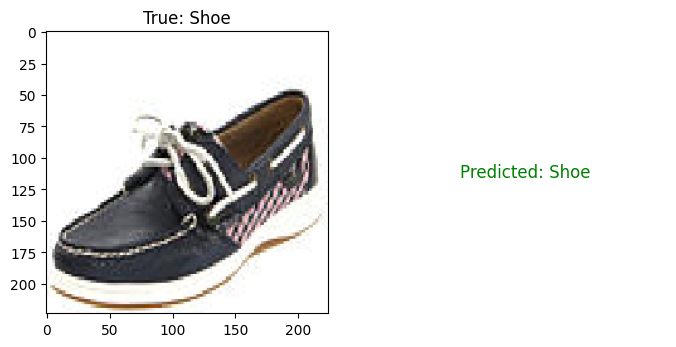

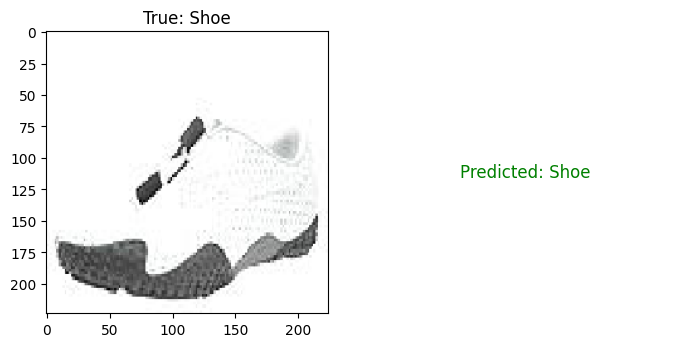

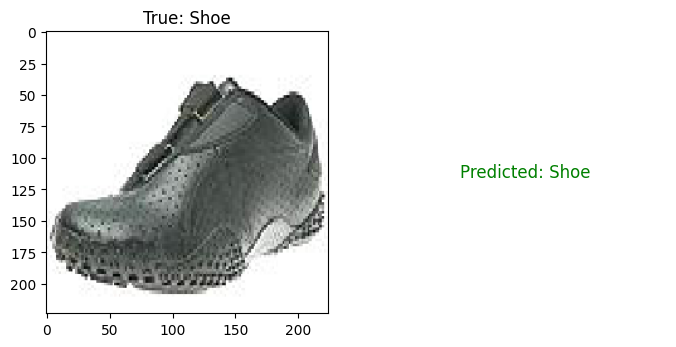

In [56]:
#Display examples of correct and incorrect predictions
def display_examples(generator, num_examples=5):
    class_labels = list(generator.class_indices.keys())
    for i in range(num_examples):
        x_batch, y_batch = next(generator)
        predictions = model.predict(x_batch)
        predicted_labels = np.argmax(predictions, axis=1)
        true_labels = np.argmax(y_batch, axis=1)

        for j in range(len(predicted_labels)):
            plt.figure(figsize=(8, 4))
            plt.subplot(1, 2, 1)
            plt.imshow(x_batch[j])
            plt.title(f'True: {class_labels[true_labels[j]]}')

            plt.subplot(1, 2, 2)
            color = 'green' if predicted_labels[j] == true_labels[j] else 'red'
            plt.text(0.5, 0.5, f'Predicted: {class_labels[predicted_labels[j]]}', color=color, fontsize=12,
                     ha='center', va='center')
            plt.axis('off')
            plt.show()

# Display examples of correct and incorrect predictions on the test set
display_examples(test_generator, num_examples=5)

**5. Train from scratch (without pretraining) a deep neural network that contains convolutional layers on this dataset (the one you created in part 3). Report classification accuracy and give a few examples of correct/incorrect classification (show a few images that were correctly/incorrectly classified).**

Found 240 images belonging to 3 classes.
Found 30 images belonging to 3 classes.
Found 30 images belonging to 3 classes.
Epoch 1/10
8/8 [==============================] - 30s 4s/step - loss: 2.4720 - accuracy: 0.3042 - val_loss: 1.0863 - val_accuracy: 0.3333
Epoch 2/10
8/8 [==============================] - 30s 3s/step - loss: 1.0739 - accuracy: 0.3833 - val_loss: 0.9208 - val_accuracy: 0.7333
Epoch 3/10
8/8 [==============================] - 29s 4s/step - loss: 1.0082 - accuracy: 0.5375 - val_loss: 0.7073 - val_accuracy: 0.7333
Epoch 4/10
8/8 [==============================] - 31s 3s/step - loss: 0.9593 - accuracy: 0.5667 - val_loss: 0.6969 - val_accuracy: 0.7333
Epoch 5/10
8/8 [==============================] - 30s 4s/step - loss: 0.9481 - accuracy: 0.5417 - val_loss: 0.7062 - val_accuracy: 0.8000
Epoch 6/10
8/8 [==============================] - 30s 3s/step - loss: 0.9619 - accuracy: 0.5375 - val_loss: 0.5971 - val_accuracy: 0.7000
Epoch 7/10
8/8 [==============================] - 3

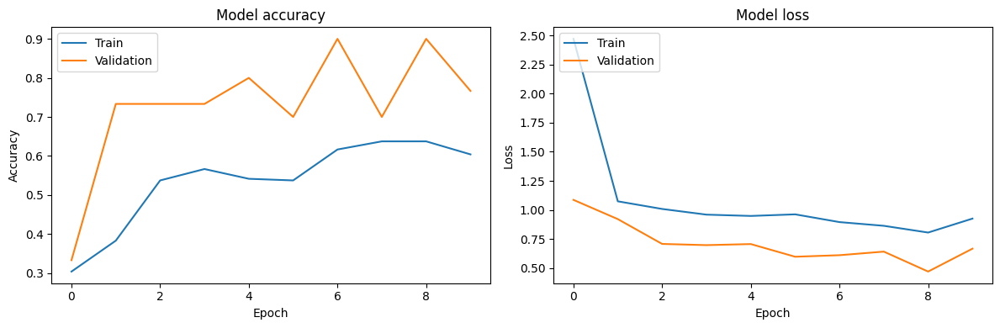

In [44]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
import numpy as np

# Define paths
train_dir = "/content/Q1_data/dataset_split/train"
valid_dir = "/content/Q1_data/dataset_split/valid"
test_dir = "/content/Q1_data/dataset_split/test"

# Define parameters
batch_size = 32
image_size = (224, 224)

# Data augmentation for training
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# No data augmentation for validation and test sets
valid_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

# Create image datasets
train_dataset = train_datagen.flow_from_directory(
    train_dir,
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=True
)

valid_dataset = valid_datagen.flow_from_directory(
    valid_dir,
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

test_dataset = test_datagen.flow_from_directory(
    test_dir,
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Build the CNN model
model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Flatten())
model.add(layers.Dense(256, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(3, activation='softmax'))

# Compile the model
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
history = model.fit(
    train_dataset,
    epochs=10,
    validation_data=valid_dataset
)

# Evaluate the model on the test set
test_loss, test_acc = model.evaluate(test_dataset)
print(f'Test accuracy: {test_acc}')

# Plot training history
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.tight_layout()
plt.show()


1/1 [==============================] - 3s 3s/step


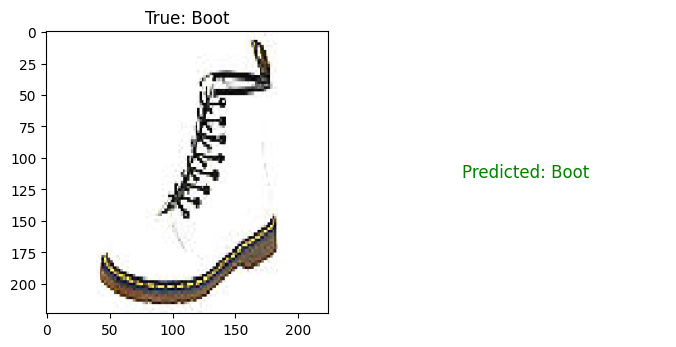

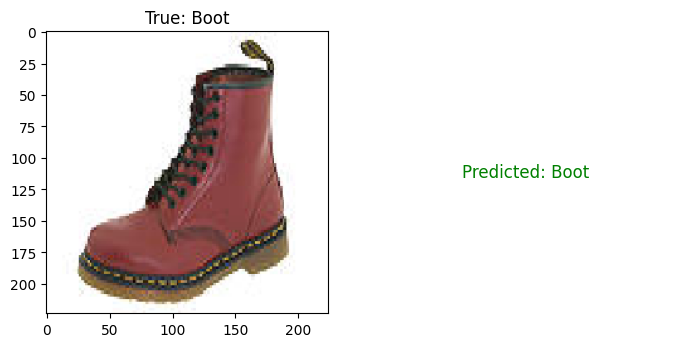

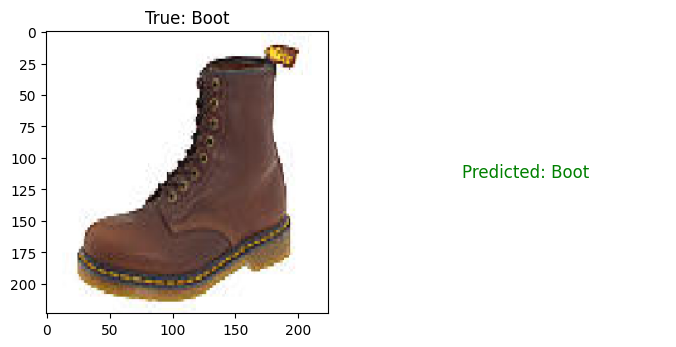

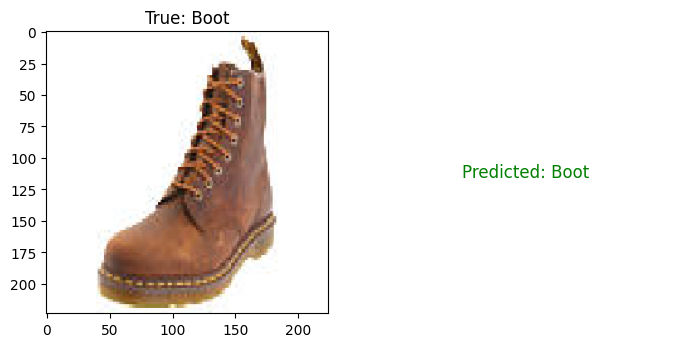

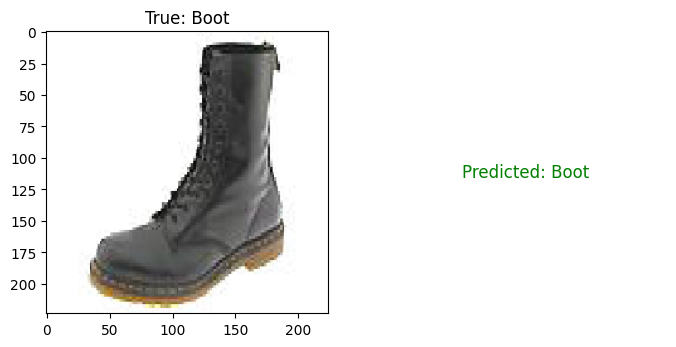

...

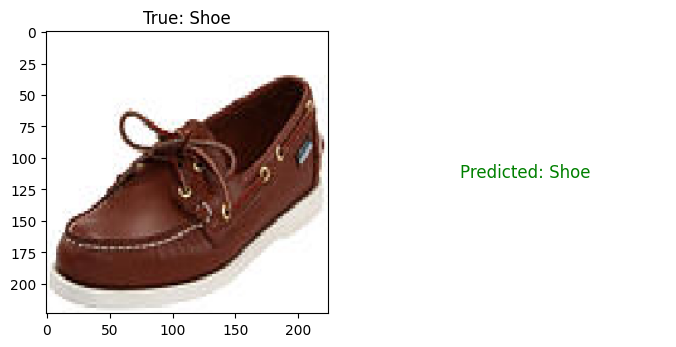

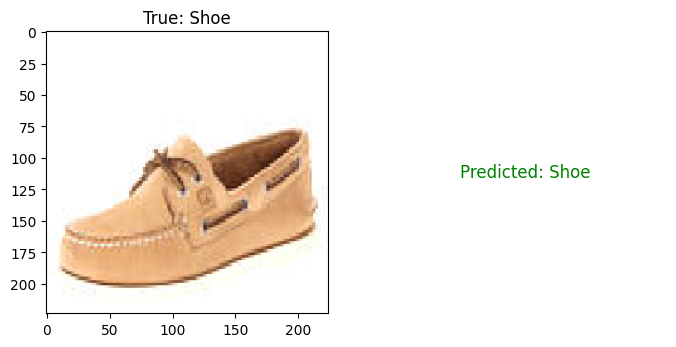

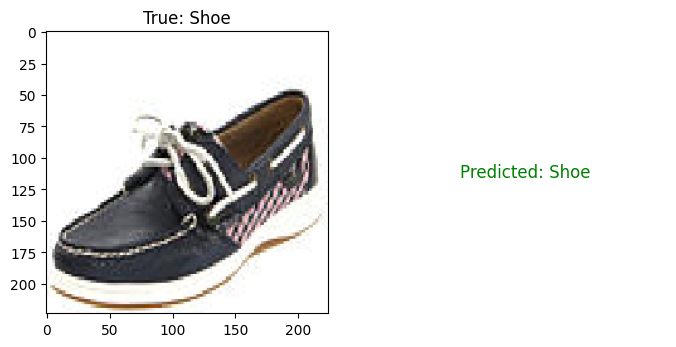

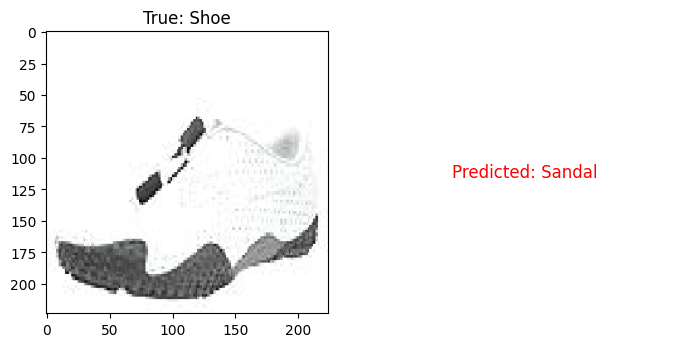

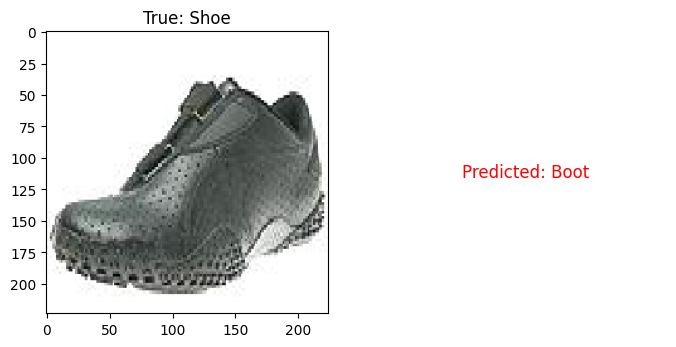

1/1 [==============================] - 1s 747ms/step


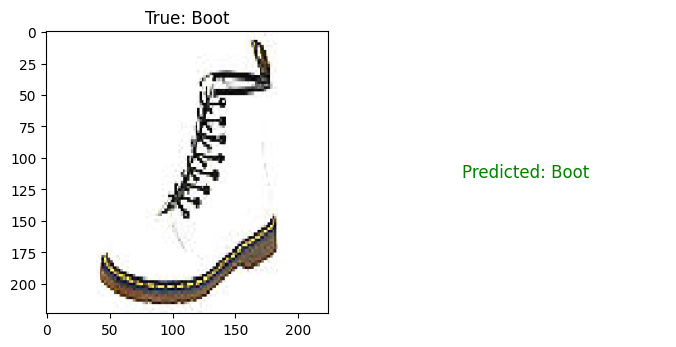

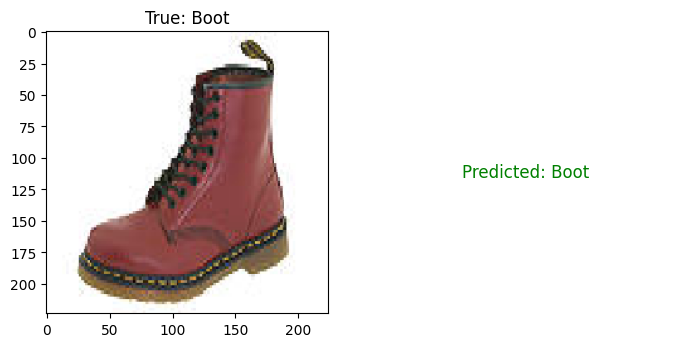

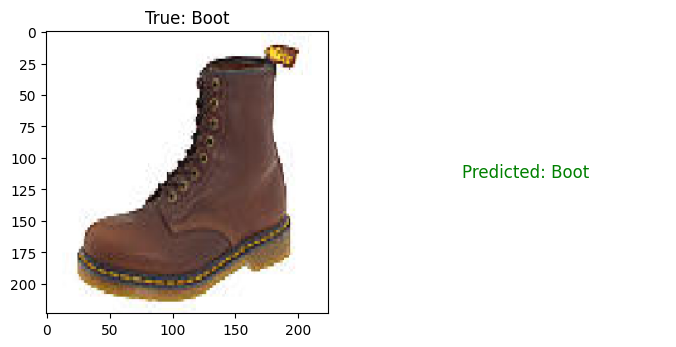

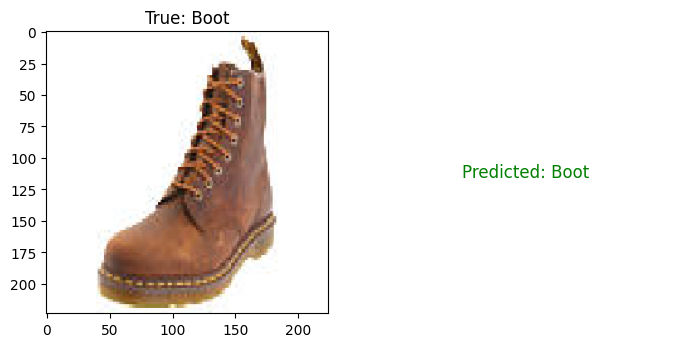

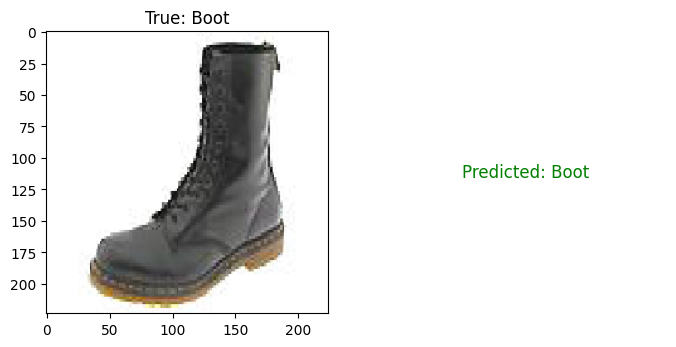

...

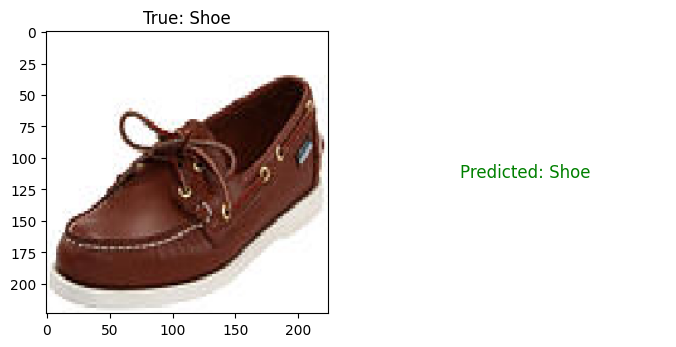

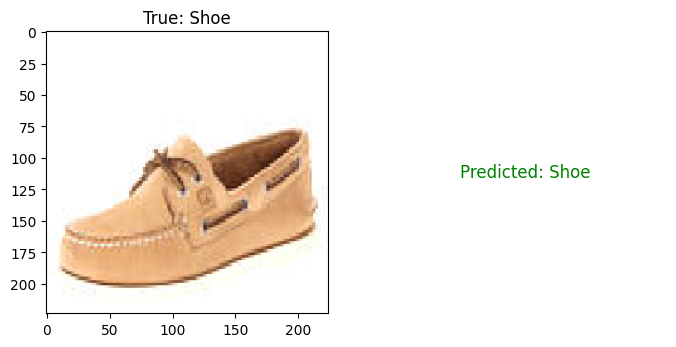

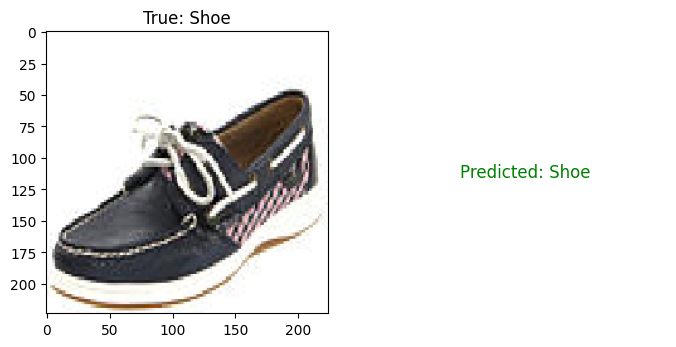

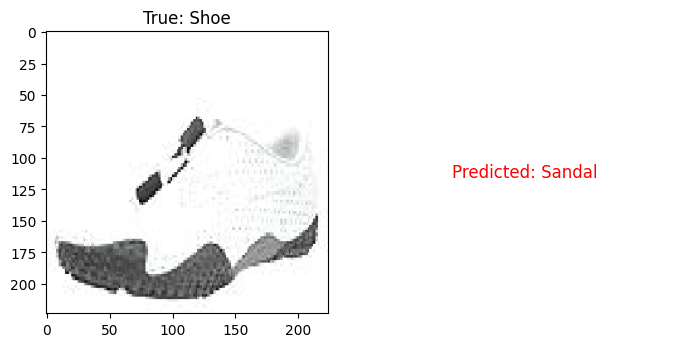

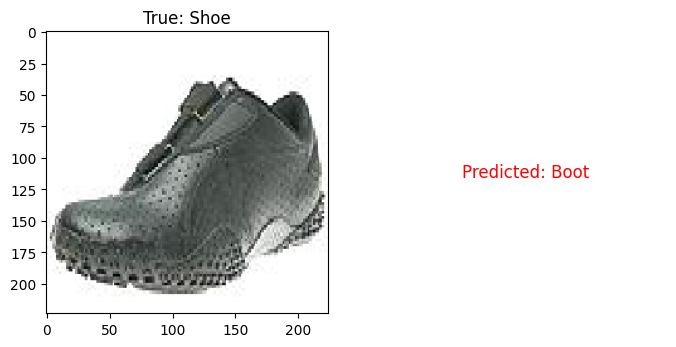

1/1 [==============================] - 1s 733ms/step


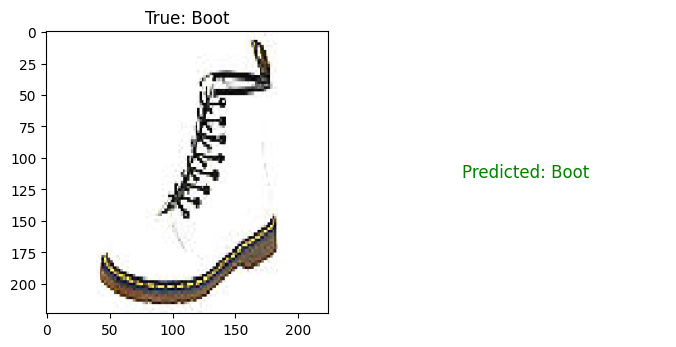

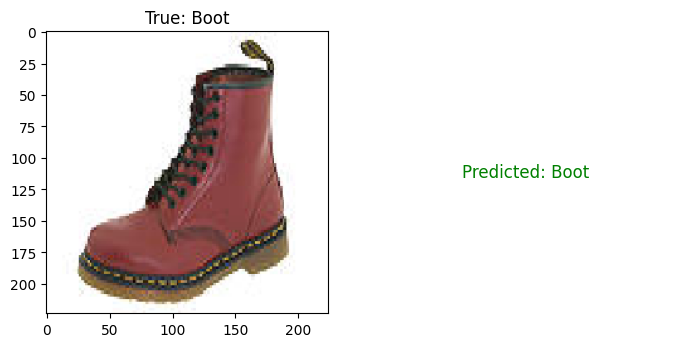

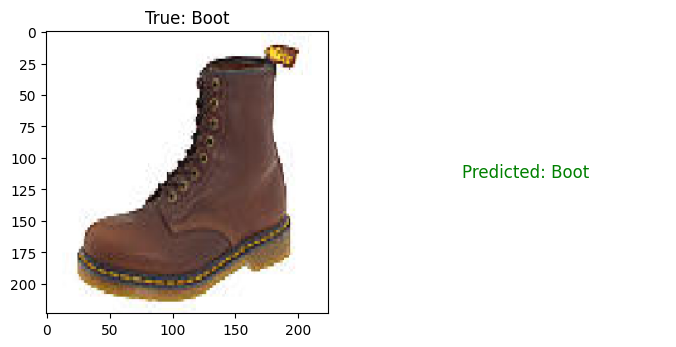

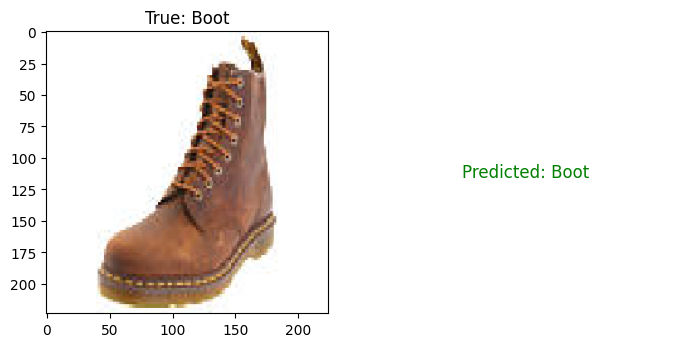

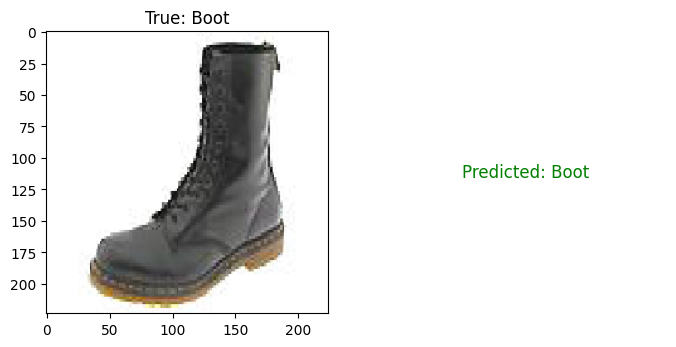

...

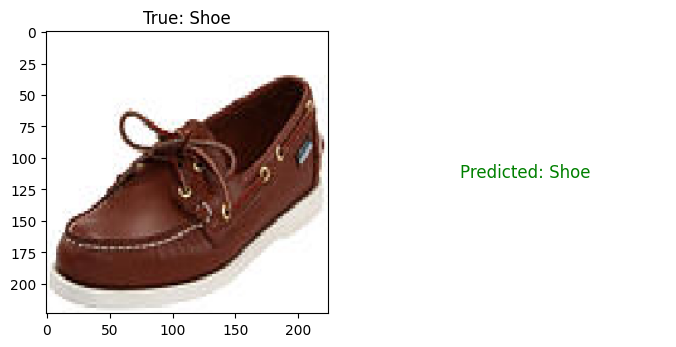

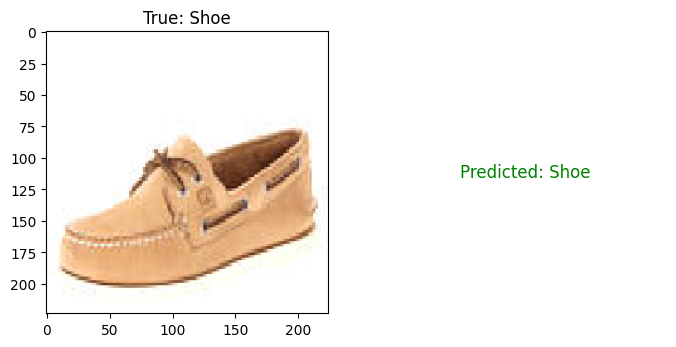

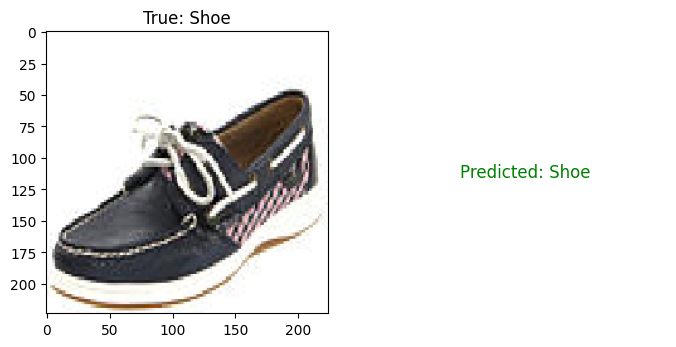

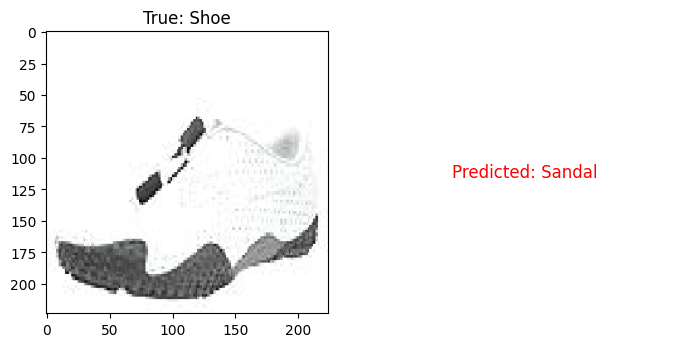

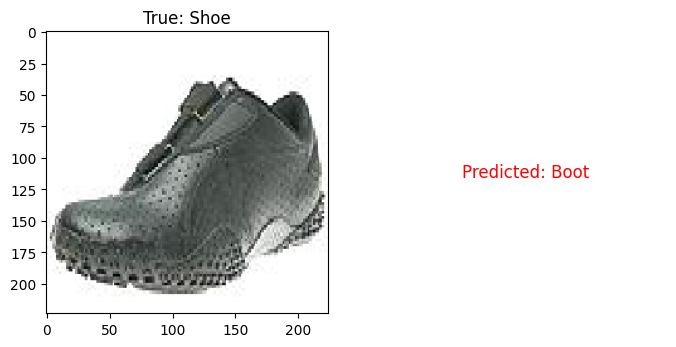

1/1 [==============================] - 1s 1s/step


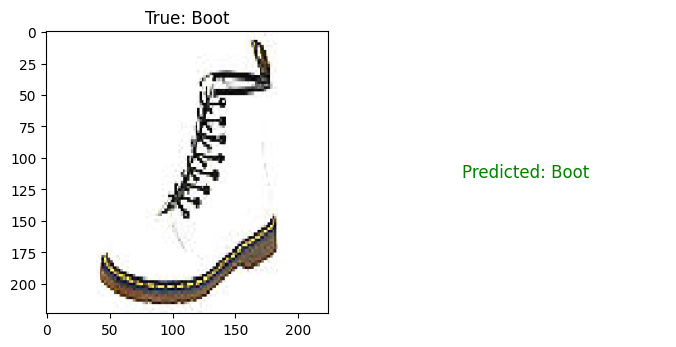

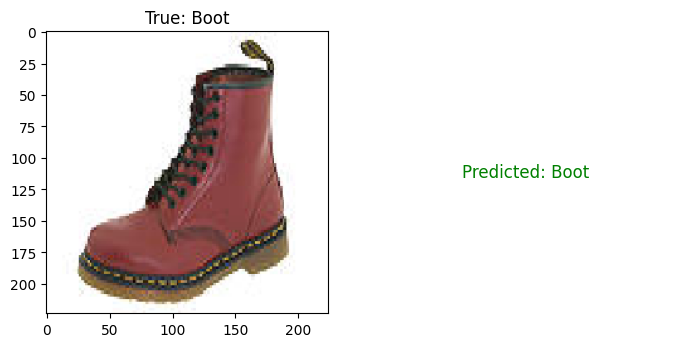

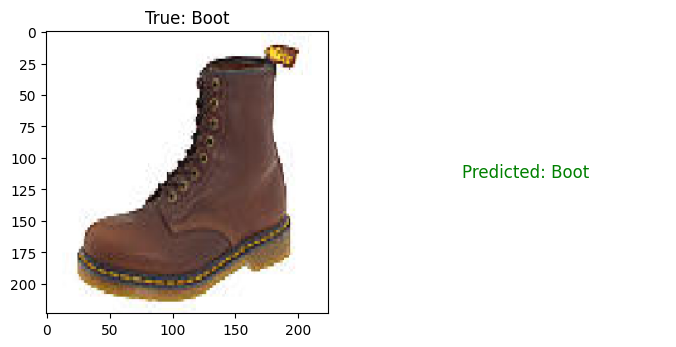

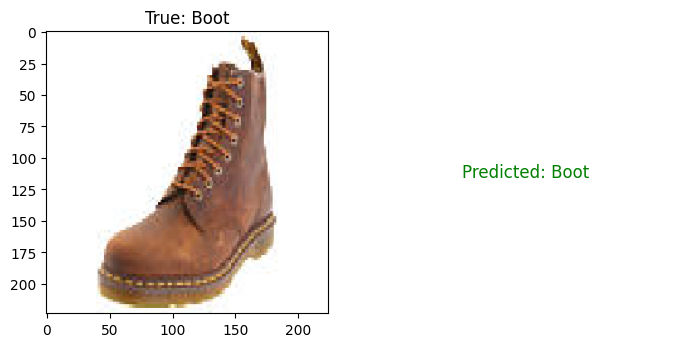

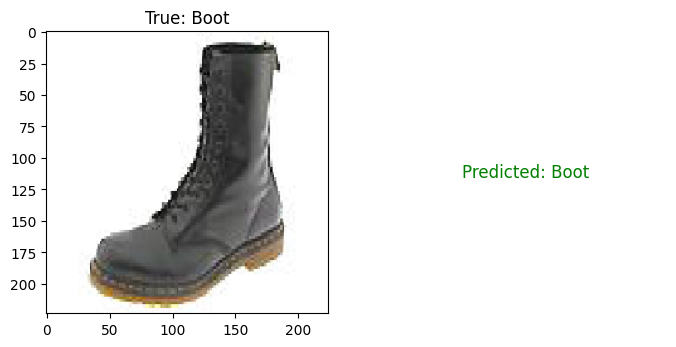

...

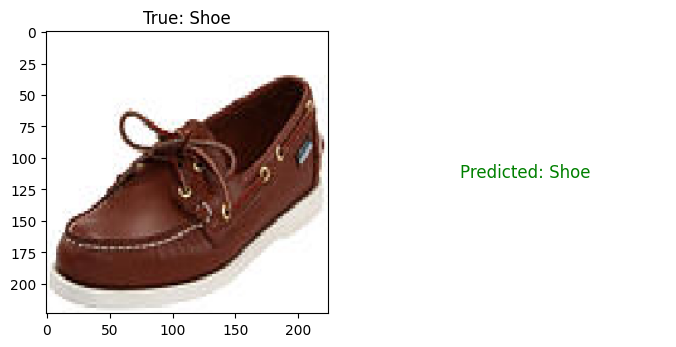

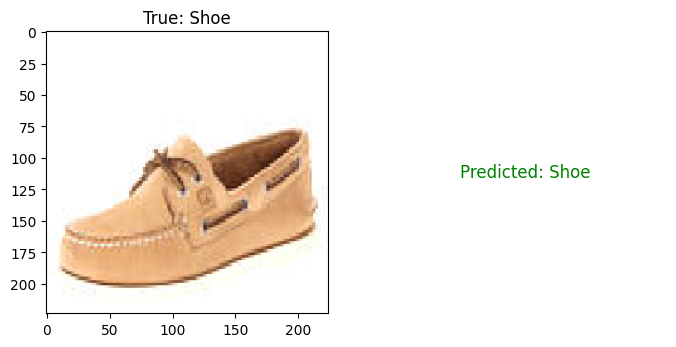

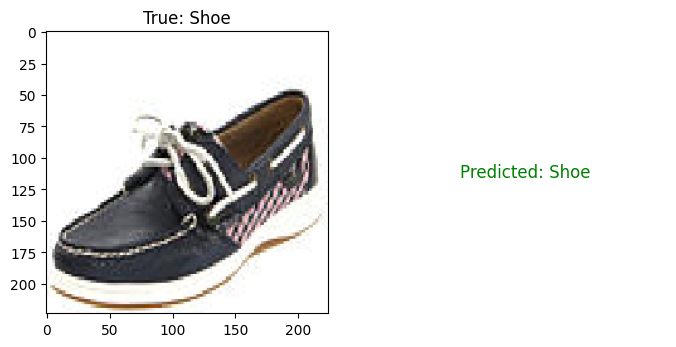

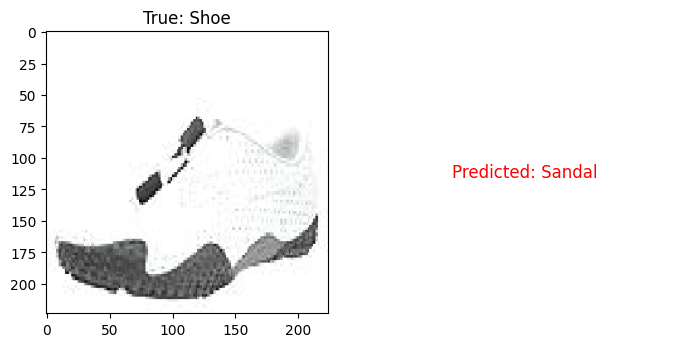

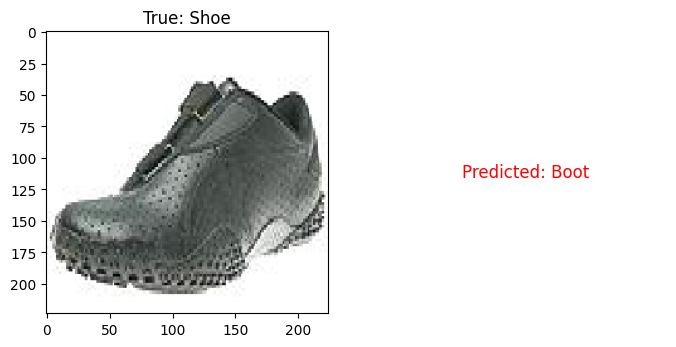

1/1 [==============================] - 1s 790ms/step


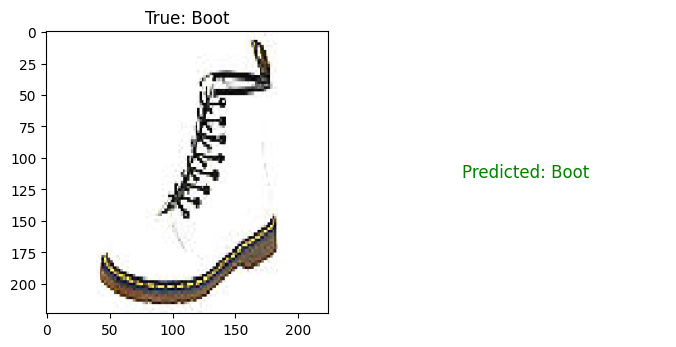

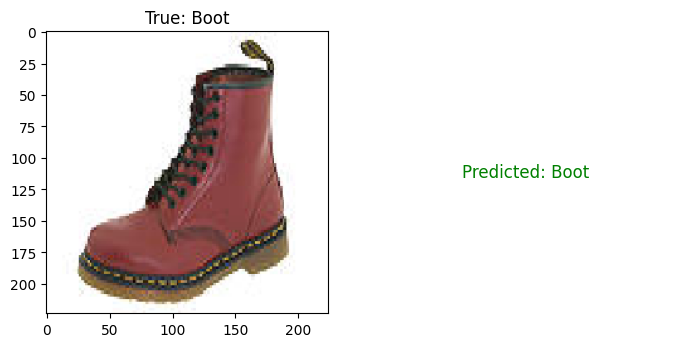

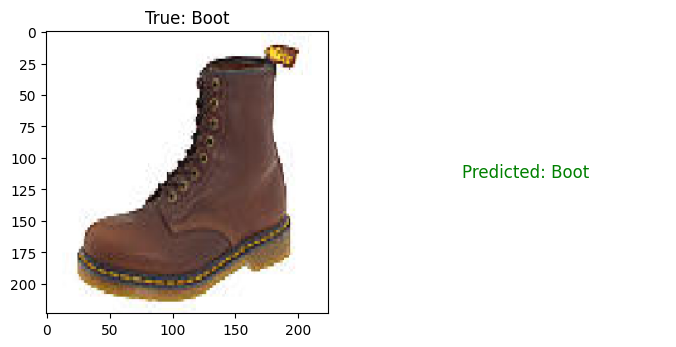

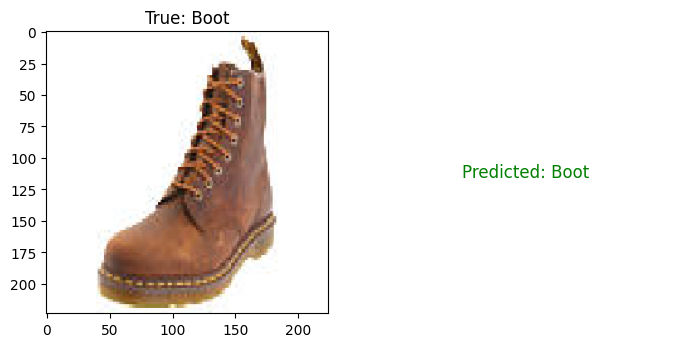

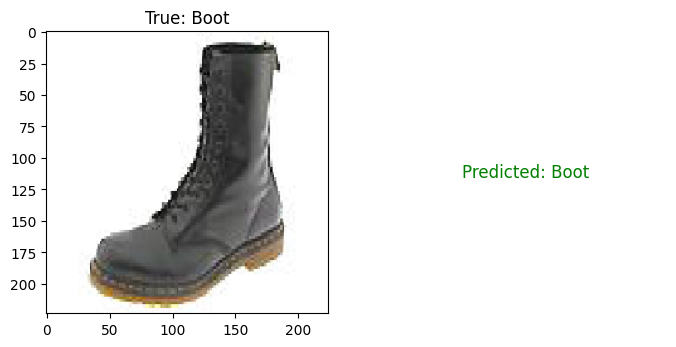

...

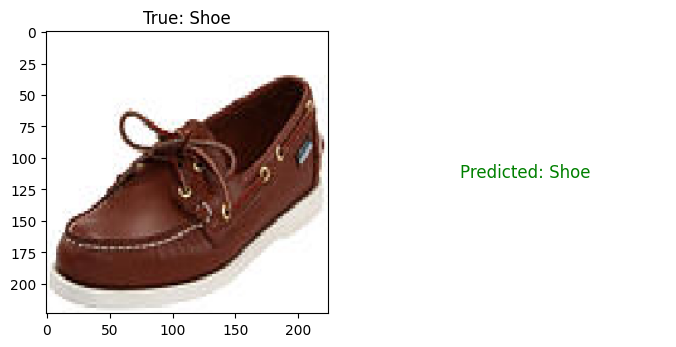

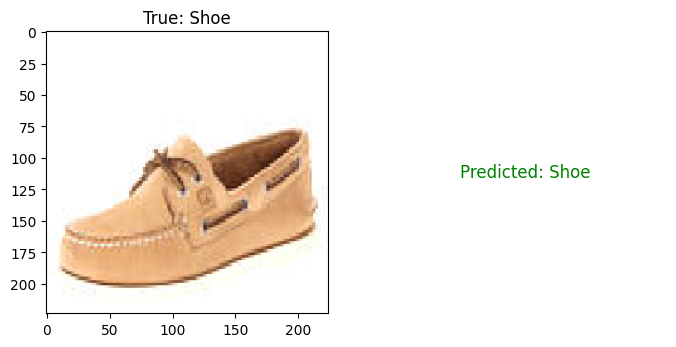

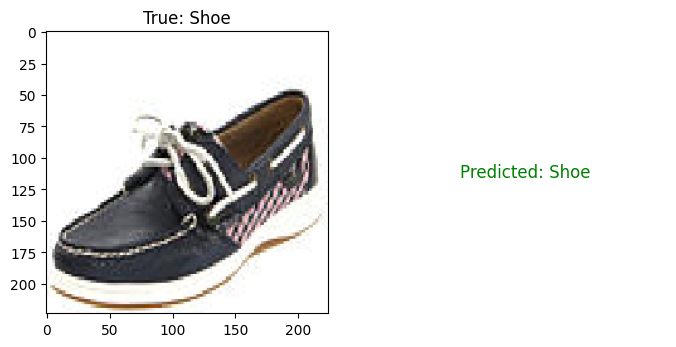

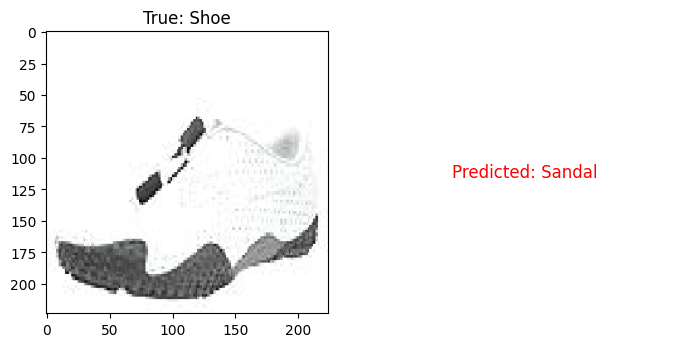

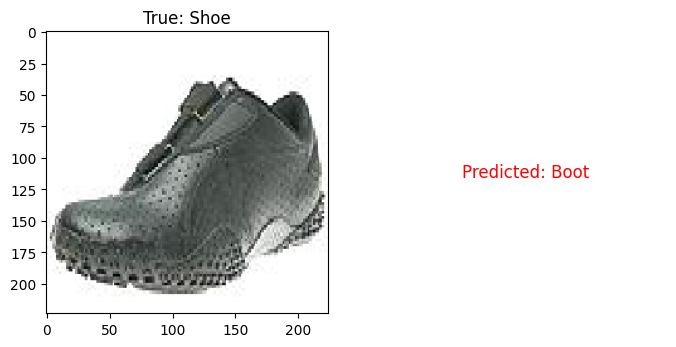

In [45]:
def display_examples(generator, num_examples=5):
    class_labels = list(generator.class_indices.keys())
    for i in range(num_examples):
        x_batch, y_batch = next(generator)
        predictions = model.predict(x_batch)
        predicted_labels = np.argmax(predictions, axis=1)
        true_labels = np.argmax(y_batch, axis=1)

        for j in range(len(predicted_labels)):
            plt.figure(figsize=(8, 4))
            plt.subplot(1, 2, 1)
            plt.imshow(x_batch[j])
            plt.title(f'True: {class_labels[true_labels[j]]}')

            plt.subplot(1, 2, 2)
            color = 'green' if predicted_labels[j] == true_labels[j] else 'red'
            plt.text(0.5, 0.5, f'Predicted: {class_labels[predicted_labels[j]]}', color=color, fontsize=12,
                     ha='center', va='center')
            plt.axis('off')
            plt.show()

# Display examples of correct and incorrect predictions on the test set
display_examples(test_dataset, num_examples=5)